In [1]:
import pandas as pd
fp = "/Users/melika/Documents/MScProject/FireData/fire_train_data.csv"
df = pd.read_csv(fp, dtype=str)

In [2]:
df['duration_days'] = df['duration_days'].astype(int)

In [3]:
defaults = {
    'SIZE_HA_log': '0', 
    'month_0':'0', 
    'month_1':'0',
    'month_10':'0',
    'month_11':'0', 
    'month_12':'0', 
    'month_2':'0', 
    'month_3':'0', 
    'month_4':'0',
    'month_5':'0', 
    'month_6':'0',
    'month_7':'0', 
    'month_8':'1', 
    'month_9':'0', 
    'cause_H':'1',
    'cause_PB':'0',
    'cause_L':'0', 
    'cause_RE':'0', 
    'cause_U':'0', 
    '1930-1939':'0',
    '1940-1949':'0',
    '1950-1959':'0',
    '1960-1969':'0',
    '1970-1979':'0',
    '1980-1989':'0',
    '1990-1999':'0',
    '2000-2009':'1',
    '2010-2019':'0',
    '2020-2019': '0',
    '2020-2029':'0',
    '1':'0', '2':'0', '3':'0', '4':'0',
    'Crown':'0', 'Dump':'0', 'Fire':'0', 'Forest':'0', 'Grass':'0', 'Ground':'0', 'IFR':'0',
       'Mutual Aid':'0', 'OFR':'0', 'Other':'0', 'Prescribed Burn':'0', 'Req For Assist':'0',
       'Request For Ass*':'0', 'Surface':'0', 'Type 1':'0', 'Type 2':'0', 'Type 3':'0', 'Type 4':'0',
       'Type 5':'0', 'Wildfire':'1', 'duration_days':0
}

(array([184542.,      0.,      0.,      0.,      0.,      0.,      0.,
             0.,      0.,  23750.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <BarContainer object of 10 artists>)

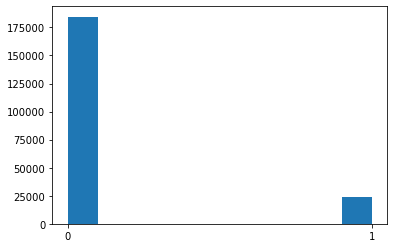

In [27]:
sizes = list(df["Wildfire"].values)
import matplotlib.pyplot as plt
plt.hist(sizes)

(array([56959., 47161., 26917., 16887., 11223.,  7861.,  5710.,  4224.,
         3266.,  2631.]),
 array([0. , 0.9, 1.8, 2.7, 3.6, 4.5, 5.4, 6.3, 7.2, 8.1, 9. ]),
 <BarContainer object of 10 artists>)

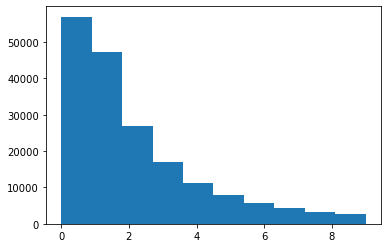

In [4]:
sizes = list(df[(df["duration_days"]<10)&(df["duration_days"]>=0)]["duration_days"].values)
import matplotlib.pyplot as plt
plt.hist(sizes)

(array([8995., 3952., 2872., 1872., 1220., 1121.,  792.,  568.,  415.,
         498.]),
 array([11. , 19.8, 28.6, 37.4, 46.2, 55. , 63.8, 72.6, 81.4, 90.2, 99. ]),
 <BarContainer object of 10 artists>)

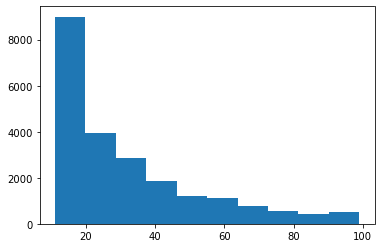

In [147]:
sizes = list(df[(df["duration_days"]<100)&(df["duration_days"]>10)]["duration_days"].values)
import matplotlib.pyplot as plt
plt.hist(sizes)

(array([446., 265., 109.,  68.,  57.,  26.,  20.,  19.,  22.,  22.]),
 array([101. , 120.2, 139.4, 158.6, 177.8, 197. , 216.2, 235.4, 254.6,
        273.8, 293. ]),
 <BarContainer object of 10 artists>)

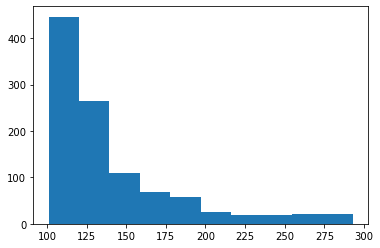

In [148]:
sizes = list(df[(df["duration_days"]<300)&(df["duration_days"]>100)]["duration_days"].values)
import matplotlib.pyplot as plt
plt.hist(sizes)

In [149]:
df["duration_days"].quantile(0.88)

10.0

In [3]:
#finding outlier
Q1 = df["duration_days"].quantile(0.25)
print(Q1)
Q3 = df["duration_days"].quantile(0.75)
print(Q3)
IQR= Q3-Q1
print(Q3+1.5*IQR)

0.0
4.0
10.0


In [4]:
#df.loc[df['duration_days'] < 0 , 'duration_days'] = -10 #Error
df = df[~(df['duration_days'] < 0)] #remove error
df.loc[df['duration_days'] > 10, 'target_days'] = 1 #large
df.loc[df['duration_days'] <= 10, 'target_days'] = 0
#df.loc[df['duration_days'] == -1, 'duration_days'] = 1
#df.loc[df['duration_days'] > 5, 'duration_days'] = -2 #Med
#df.loc[df['duration_days'] > 2, 'duration_days'] = -3 #Med Low
#df.loc[df['duration_days'] == 2, 'duration_days'] = 2 #2
#df.loc[df['duration_days'] == 1, 'duration_days'] = 1 #1
#df.loc[df['duration_days'] == 0, 'duration_days'] = 0 #0

In [152]:
df.head()

,Unnamed: 0,SIZE_HA_log,ECOZONE,month_0,month_1,month_10,month_11,month_12,month_2,month_3,...,Req For Assist,Request For Ass*,Surface,Type 1,Type 2,Type 3,Type 4,Type 5,Wildfire,duration_days
0,5,3,5,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
1,6,0,5,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
2,7,1,5,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
3,8,0,6,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,9,0,6,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


(array([184846.,      0.,      0.,      0.,      0.,      0.,      0.,
             0.,      0.,  23446.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <BarContainer object of 10 artists>)

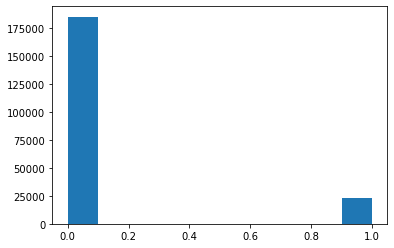

In [153]:
x = list(df['duration_days'].values)
plt.hist(x)

In [5]:
label_col = 'target_days'
all_label_values = list(set(list(df[label_col].values)))
print(all_label_values)

[0.0, 1.0]


In [6]:
gp1 = df.loc[df['ECOZONE'] == '6']
gp2 = df.loc[df['ECOZONE'] == '14']
print(gp1.shape , gp2.shape)

(108608, 58) (3877, 58)


In [7]:
from collections import defaultdict
counter_dict = defaultdict(lambda: 0) #h ^ v, the keys would be (h, column_name, value of column)
not_counter_dict =  defaultdict(lambda: 0)
columns = list(gp1.columns)
columns.remove(label_col)
columns.remove('Unnamed: 0')
columns.remove('ECOZONE')
for index, row in gp1.iterrows():
    h = row[label_col]
    for c in columns:
        key = (h, c, row[c])
        counter_dict[key] += 1
        for val in all_label_values:
            if val != h:
                not_counter_dict[(val, c, row[c])] += 1
        

In [8]:
from collections import defaultdict
counter_dict2 = defaultdict(lambda: 0) #h ^ v, the keys would be (h, column_name, value of column)
not_counter_dict2 =  defaultdict(lambda: 0)
columns = list(gp2.columns)
columns.remove(label_col)
columns.remove('Unnamed: 0')
columns.remove('ECOZONE')

for index, row in gp2.iterrows():
    h = row[label_col]
    for c in columns:
        key = (h, c, row[c])
        counter_dict2[key] += 1
        for val in all_label_values:
            if val != h:
                not_counter_dict2[(val, c, row[c])] += 1
        

In [9]:
c0 = 0
c1 = 0
p = defaultdict(lambda: 0) # a dictionary for p(h | v_i), the keys would be (h, column_name, value of column)
p2 = defaultdict(lambda: 0) # a dictionary for p(h | v_i), the keys would be (h, column_name, value of column)
    
for index, row in gp1.iterrows():
    h = row[label_col]
    for c in columns:
        key = (h, c, row[c])
        p[key] = (counter_dict[key] + c0) / (counter_dict[key] + not_counter_dict[key] + c1)
        

In [41]:
for index, row in gp2.iterrows():
    h = row[label_col]
    for c in columns:
        key = (h, c, row[c])
        p2[key] = (counter_dict2[key] + c0) / (counter_dict2[key] + not_counter_dict2[key] + c1)
        

In [51]:
h = 1

In [55]:
ratio_prob = []
direct_prob = []
labels = []
counter_p2_0 = 0
counter_p0 = 0
counter_ratio1 = 0
ods_prob = []
ods_mult_prob = []
print("shape", gp2.shape)
for index, row in gp2.iterrows():

    r = row[label_col]

    for c in columns:
        key = (h, c, row[c])
        def_key = (h, c, defaults[c])
        #print(key, def_key)
        if p2[def_key] == 0:
            counter_p2_0 +=1 
            print("p2 is zero", def_key)
        if p[def_key] == 0:
            counter_p0 += 1
            print("Can not calculate ratio, p default is not available", key, def_key)
            continue
        ratio_p = (p[key]/p[def_key]) * p2[def_key]
        if p[key] >= 1 or p2[key] >= 1:
            continue
        odds_1 = p[key] / (1-p[key])
        odds_2 = p2[key] / (1-p2[key])
        if ratio_p > 1:
            counter_ratio1 = 0
            print("ratio prob greater than 1", key, def_key, ratio_p, p[key], p[def_key], p2[def_key])
            continue
        direct_p = p[key]
        ratio_prob.append(ratio_p)
        direct_prob.append(direct_p)
        labels.append(row[label_col])
        odds_def1 = p[def_key] / (1-p[def_key])
        odds_def2 = p2[def_key] / (1-p2[def_key])
        ods_pred = odds_1 - odds_def1 + odds_def2
        mult_pred = odds_1 * odds_def2 / odds_def1 
        ods_prob.append(ods_pred / (1 + ods_pred))
        ods_mult_prob.append(mult_pred/(1+mult_pred))

shape (3877, 57)
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-1') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '1') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0

Can not calculate ratio, p default is not available (1, 'cause_L', '1') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1,

Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground'

Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '1') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', 

Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '1') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not cal

p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '0') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '1') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not availa

p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '1') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '0') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '0') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '

p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0'

p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate r

Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '1') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type

Can not calculate ratio, p default is not available (1, 'Surface', '0') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-1') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calcula

Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-6') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3

Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calcul

Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '1') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '0') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '1') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not 

Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '1') (1, '1980-1989', '0')
p2 is zer

p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '1') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '0') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '0') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1

p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, '

p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '1') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR'

p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '1') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero

Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1,

Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '0') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '1') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '

Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not avail

p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '1') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p d

Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not

Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '1') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '0') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calcu

p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959

p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '1') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '0') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-20

p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '0') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '0') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default 

p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '1') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR'

Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate

Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '1') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Ty

Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '1') (1, 'Surface

Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calc

p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '0') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '1') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0'

Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Gra

Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '1') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can no

p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-1') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (

p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is z

p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '0') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not availab

Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '1') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not avail

Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, '

Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '0') (1, 'Surface

Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '1') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can no

p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '1') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not avai

Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '1') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '0') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '0') (1, '2010-2019', '0')
p

p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '0') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '0') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default 

p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR'

p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p

Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '1') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', 

Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '1') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not 

p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '1') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero

Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '1') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '0') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '0') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')


Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '0') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not cal

Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '1') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Ty

Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not avail

p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '0') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', 

Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '1') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '0') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '0') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p

p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-1') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_

p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '0') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '1') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0'

Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '1') (1, '1990-1999', '0')
p2 is

p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '1') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, '

Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For As

Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '1') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '0') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '0') (1, '2010-2019', '0')
p

Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '1') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not cal

p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p

Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3

p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p

Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-1') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0'

p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '1') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p

Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '1') (1, 'Surface

Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '1') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '0') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '0') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')


Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not avail

Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '1') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Ty

Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '0') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not cal

p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '1') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-20

p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '1') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '196

Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '1') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground'

p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p defau

Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calc

Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-1') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0'

p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')


Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero

Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Oth

p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '1') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '0') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '

p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '1') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-20

p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '1') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '0') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-20

p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '1') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, '

p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '1') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'T

Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '

Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0'

Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-1') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3

Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Oth

Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '1') (1, 'Surface

p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '1') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '0') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default 

p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero

p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, '

Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '0') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '1') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Ca

p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (

Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '1') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calcul

Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '1') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Oth

Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero

Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '1') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '0') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calcu

Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calcul

Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2'

p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '1') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not avai

p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire',

Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '0') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', 

p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-20

p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '1') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1

Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Gra

Can not calculate ratio, p default is not available (1, '2010-2019', '0') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', 

Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, '

Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not avail

Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '1') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calcula

p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, '

p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')


Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is ze

p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '1') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is z

Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0'

p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '1') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero

Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, '

Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate

Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0'

Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-19

p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '1') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero

p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p d

Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '1') (1, '2000-2009', '1')
p

p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '1') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p

p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959

Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '1') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculat

Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0'

Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '1') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildf

Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1,

p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '1') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p

p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '1') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '0') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '

p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '1') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not avai

p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is z

p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '196

p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, '

Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '1') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '0') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')


Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-1') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calcul

Can not calculate ratio, p default is not available (1, '2000-2009', '1') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '0') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0'

p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '1') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'T

Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero

Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, '

p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, '

p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '1') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p

p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12',

p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero

Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calc

Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '19

Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '1') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '0') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p

Can not calculate ratio, p default is not available (1, '2010-2019', '1') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', 

Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0'

Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0'

p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '0') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p

p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '1') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1

p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '1') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero

p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0')

Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '0') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '1') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p

Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero

Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, '

p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-20

Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0'

Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '1') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculat

p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '0') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 

p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '0') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '1') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default 

Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zer

p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '0') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p

Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0'

Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '1') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not 

Can not calculate ratio, p default is not available (1, 'month_5', '1') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calc

Can not calculate ratio, p default is not available (1, '2000-2009', '0') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '1') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0'

Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '1') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calcula

Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '0') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Ty

p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')


p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '1') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1

p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '196

Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not

Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, '

Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3

Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0'

p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3',

Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '0') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '1') (1, '2010-2019', '0')
p

p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0

p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, '

Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not 

Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '1') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not cal

p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '0') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-20

Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can 

Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0'

Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-19

Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '1') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calcul

p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '0') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 

Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '0') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '1') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio,

p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0

p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '1') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0'

Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3

Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '1') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can no

Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '1') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2

Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '1') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not

Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2'

Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '0') (1, '2000-2009', '1')
p

Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is

p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '1') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '0') (1, 'cause_H', '1')
p2 is zero (1, '

p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 i

Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '1') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calcula

p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 i

p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, '

Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '1') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculat

p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is z

p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '1') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero

Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '0') (1, 'Surface

Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '0') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type

Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not

Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '19

p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, '

p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0

p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero

Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '0') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '1') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio,

Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '0') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildf

p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is 

p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '1') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is z

Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, '

p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '1') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is z

p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For A

p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959

Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '19

Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zer

Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '0') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '1') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not availa

Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0'

Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3

p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is z

Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2

p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '1') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero

p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is z

Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '0') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Ty

Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '19

p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959

Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not ca

Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '0') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '1') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio,

Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For As

Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2'

Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '0') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '1') (1, '2010-2019', '0')
p

Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, '

p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 

p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '1') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1

p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '0') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '1') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-20

p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire',

Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '0') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type

Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can 

Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '1') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calcula

Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '1') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not ca

Can not calculate ratio, p default is not available (1, '2010-2019', '1') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', 

Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '0') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type

p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '1') (1, 'month_4', '0')
p2 is z

p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (

p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, '

p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p defau

p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR'

Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0'

Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '1') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculat

Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Ca

Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is

Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '0') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '1') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio,

p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0'

p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate r

p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '0') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'T

p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 

Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3

Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '1') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calcul

Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not 

Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zer

Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '0') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '1') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')


Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '0') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '1') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not 

p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '0') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not availab

p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (

p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is z

p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '1') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, '

Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '1') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Ca

Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is

Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '1') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type

Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '1') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For As

Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not 

Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '1') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not cal

Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-19

Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '0') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '1') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')


Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '

p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '0') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not avai

Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not ca

Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-1') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0'

Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '19

Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '0') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '1') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p

Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '0') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type

p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, '

p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is z

p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '0') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, '

p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '1') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '0') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '0') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-20

Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1,

Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero

Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '0') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')

p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '

Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '0') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '1') (1, '2010-2019', '0')
p

Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not ca

Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '0') (1, 'Surface

Can not calculate ratio, p default is not available (1, 'month_7', '1') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not 

p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '1') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, '

p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 i

p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is z

Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is ze

p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '0') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '1') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-20

Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-1') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0'

Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '19

Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '1') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calcula

Can not calculate ratio, p default is not available (1, 'cause_H', '0') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '1') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-19

p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '0') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2

p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '196

Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not ca

Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not avail

Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '0') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can no

Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '1') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildf

Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '1') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '0') (1, '2010-2019', '0')
p

Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, '

Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '1') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', 

p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, '

p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '1') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '0') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '0') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-20

Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '1') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '0') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p

Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '1') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For As

p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate r

p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '1') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1

Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '1') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '0') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio,

p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '0') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2

Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '1') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can no

p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '1') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, '

Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0'

p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '0') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, '

p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '0') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p

Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not

p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero

Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '0') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can no

Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not ca

Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '1') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '0') (1, '2010-2019', '0')
p

p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, '

Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '0') (1, 'Surface

Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '0') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can n

p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, '

p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 i

p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '1') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '0') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default 

p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-1') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 

p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not availa

Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '1') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calcul

Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '1') (1, '2000-2009', '1')
p

Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '1') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '0') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')


Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not

p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')


p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0'

p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '0') (1, 'Surface', '0')
p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not availab

p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '1') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, '

p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '1') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '0') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-20

p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0')

Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '1') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculat

p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p d

p2 is zero (1, 'Type 1', '0')
Can not calculate ratio, p default is not available (1, 'Type 1', '0') (1, 'Type 1', '0')
p2 is zero (1, 'Type 2', '0')
Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 

p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '1') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '0') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-20

Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-1') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0'

p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '1') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '0') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-20

p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate r

p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is 

p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero

Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '1') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '0') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')


Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '1') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate

Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0'

Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not 

Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '1') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '0') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1', '0')
p2 is zero (1, '2', '0')
Can not calculate ratio, p default is not available (1, '2', '0') (1, '2', '0')
p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not availa

Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0'

p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12', '0')
p2 is zero (1, 'month_2', '0')
Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_

p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0'

p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-20

p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not availa

Can not calculate ratio, p default is not available (1, 'month_2', '0') (1, 'month_2', '0')
p2 is zero (1, 'month_3', '0')
Can not calculate ratio, p default is not available (1, 'month_3', '0') (1, 'month_3', '0')
p2 is zero (1, 'month_4', '0')
Can not calculate ratio, p default is not available (1, 'month_4', '0') (1, 'month_4', '0')
p2 is zero (1, 'month_5', '0')
Can not calculate ratio, p default is not available (1, 'month_5', '0') (1, 'month_5', '0')
p2 is zero (1, 'month_6', '0')
Can not calculate ratio, p default is not available (1, 'month_6', '0') (1, 'month_6', '0')
p2 is zero (1, 'month_7', '0')
Can not calculate ratio, p default is not available (1, 'month_7', '0') (1, 'month_7', '0')
p2 is zero (1, 'month_8', '1')
Can not calculate ratio, p default is not available (1, 'month_8', '1') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculat

Can not calculate ratio, p default is not available (1, 'Type 2', '0') (1, 'Type 2', '0')
p2 is zero (1, 'Type 3', '0')
Can not calculate ratio, p default is not available (1, 'Type 3', '0') (1, 'Type 3', '0')
p2 is zero (1, 'Type 4', '0')
Can not calculate ratio, p default is not available (1, 'Type 4', '0') (1, 'Type 4', '0')
p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not ca

Can not calculate ratio, p default is not available (1, 'month_8', '0') (1, 'month_8', '1')
p2 is zero (1, 'month_9', '0')
Can not calculate ratio, p default is not available (1, 'month_9', '0') (1, 'month_9', '0')
p2 is zero (1, 'cause_H', '1')
Can not calculate ratio, p default is not available (1, 'cause_H', '1') (1, 'cause_H', '1')
p2 is zero (1, 'cause_PB', '0')
Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Ca

Can not calculate ratio, p default is not available (1, 'cause_PB', '0') (1, 'cause_PB', '0')
p2 is zero (1, 'cause_L', '0')
Can not calculate ratio, p default is not available (1, 'cause_L', '0') (1, 'cause_L', '0')
p2 is zero (1, 'cause_RE', '0')
Can not calculate ratio, p default is not available (1, 'cause_RE', '0') (1, 'cause_RE', '0')
p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '19

Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '1') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2

Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate

p2 is zero (1, 'Type 5', '0')
Can not calculate ratio, p default is not available (1, 'Type 5', '0') (1, 'Type 5', '0')
p2 is zero (1, 'Wildfire', '1')
Can not calculate ratio, p default is not available (1, 'Wildfire', '0') (1, 'Wildfire', '1')
p2 is zero (1, 'SIZE_HA_log', '0')
Can not calculate ratio, p default is not available (1, 'SIZE_HA_log', '-2') (1, 'SIZE_HA_log', '0')
p2 is zero (1, 'month_0', '0')
Can not calculate ratio, p default is not available (1, 'month_0', '0') (1, 'month_0', '0')
p2 is zero (1, 'month_1', '0')
Can not calculate ratio, p default is not available (1, 'month_1', '0') (1, 'month_1', '0')
p2 is zero (1, 'month_10', '0')
Can not calculate ratio, p default is not available (1, 'month_10', '0') (1, 'month_10', '0')
p2 is zero (1, 'month_11', '0')
Can not calculate ratio, p default is not available (1, 'month_11', '0') (1, 'month_11', '0')
p2 is zero (1, 'month_12', '0')
Can not calculate ratio, p default is not available (1, 'month_12', '0') (1, 'month_12',

p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '0') (1, '1990-1999', '0')
p2 is zero (1, '2000-2009', '1')
Can not calculate ratio, p default is not available (1, '2000-2009', '1') (1, '2000-2009', '1')
p2 is zero (1, '2010-2019', '0')
Can not calculate ratio, p default is not available (1, '2010-2019', '0') (1, '2010-2019', '0')
p2 is zero (1, '2020-2019', '0')
Can not calculate ratio, p default is not available (1, '2020-2019', '0') (1, '2020-2019', '0')
p2 is zero (1, '2020-2029', '0')
Can not calculate ratio, p default is not available (1, '2020-2029', '0') (1, '2020-2029', '0')
p2 is zero (1, '1', '0')
Can not calculate ratio, p default is not available (1, '1', '0') (1, '1

p2 is zero (1, 'cause_U', '0')
Can not calculate ratio, p default is not available (1, 'cause_U', '0') (1, 'cause_U', '0')
p2 is zero (1, '1930-1939', '0')
Can not calculate ratio, p default is not available (1, '1930-1939', '0') (1, '1930-1939', '0')
p2 is zero (1, '1940-1949', '0')
Can not calculate ratio, p default is not available (1, '1940-1949', '0') (1, '1940-1949', '0')
p2 is zero (1, '1950-1959', '0')
Can not calculate ratio, p default is not available (1, '1950-1959', '0') (1, '1950-1959', '0')
p2 is zero (1, '1960-1969', '0')
Can not calculate ratio, p default is not available (1, '1960-1969', '0') (1, '1960-1969', '0')
p2 is zero (1, '1970-1979', '0')
Can not calculate ratio, p default is not available (1, '1970-1979', '0') (1, '1970-1979', '0')
p2 is zero (1, '1980-1989', '0')
Can not calculate ratio, p default is not available (1, '1980-1989', '0') (1, '1980-1989', '0')
p2 is zero (1, '1990-1999', '0')
Can not calculate ratio, p default is not available (1, '1990-1999', '

p2 is zero (1, '3', '0')
Can not calculate ratio, p default is not available (1, '3', '0') (1, '3', '0')
p2 is zero (1, '4', '0')
Can not calculate ratio, p default is not available (1, '4', '0') (1, '4', '0')
p2 is zero (1, 'Crown', '0')
Can not calculate ratio, p default is not available (1, 'Crown', '0') (1, 'Crown', '0')
p2 is zero (1, 'Dump', '0')
Can not calculate ratio, p default is not available (1, 'Dump', '0') (1, 'Dump', '0')
p2 is zero (1, 'Fire', '0')
Can not calculate ratio, p default is not available (1, 'Fire', '0') (1, 'Fire', '0')
p2 is zero (1, 'Forest', '0')
Can not calculate ratio, p default is not available (1, 'Forest', '0') (1, 'Forest', '0')
p2 is zero (1, 'Grass', '0')
Can not calculate ratio, p default is not available (1, 'Grass', '0') (1, 'Grass', '0')
p2 is zero (1, 'Ground', '0')
Can not calculate ratio, p default is not available (1, 'Ground', '0') (1, 'Ground', '0')
p2 is zero (1, 'IFR', '0')
Can not calculate ratio, p default is not available (1, 'IFR'

Can not calculate ratio, p default is not available (1, 'IFR', '0') (1, 'IFR', '0')
p2 is zero (1, 'Mutual Aid', '0')
Can not calculate ratio, p default is not available (1, 'Mutual Aid', '0') (1, 'Mutual Aid', '0')
p2 is zero (1, 'OFR', '0')
Can not calculate ratio, p default is not available (1, 'OFR', '0') (1, 'OFR', '0')
p2 is zero (1, 'Other', '0')
Can not calculate ratio, p default is not available (1, 'Other', '0') (1, 'Other', '0')
p2 is zero (1, 'Prescribed Burn', '0')
Can not calculate ratio, p default is not available (1, 'Prescribed Burn', '0') (1, 'Prescribed Burn', '0')
p2 is zero (1, 'Req For Assist', '0')
Can not calculate ratio, p default is not available (1, 'Req For Assist', '0') (1, 'Req For Assist', '0')
p2 is zero (1, 'Request For Ass*', '0')
Can not calculate ratio, p default is not available (1, 'Request For Ass*', '0') (1, 'Request For Ass*', '0')
p2 is zero (1, 'Surface', '0')
Can not calculate ratio, p default is not available (1, 'Surface', '0') (1, 'Surface

In [53]:
print(len(labels))

0


In [15]:
from math import log2
direct_loss = 0
ratio_loss = 0
odd_loss = 0
counter = 0
error_cnt = 0 
mult_loss = 0
for i in range(len(labels)):
    counter += 1

    try:
        direct = direct_prob[i]
        rat = ratio_prob[i]
        od = ods_prob[i]
        mult = ods_mult_prob[i]
        #print(direct, rat, labels[i])

        #if labels[i] == 1:
        #   rat = 1-rat
        #  direct = 1-direct
        y = labels[i]
        l1 = -(y * log2(direct) + (1-y)*log2(1-direct))
        l2 = -(y * log2(rat) + (1-y)*log2(1-rat))
        l3 = -(y * log2(od) + (1-y)*log2(1-od))
        print("mult,", mult)
        l4 = -(y * log2(mult) + (1-y)*log2(1-mult))
        if counter % 10000 == 0:
            print(counter)
            print(l1 , l2, l3)
        direct_loss += l1
        ratio_loss += l2
        odd_loss += l3
        mult_loss += l4
    except Exception as E:
        print(E)
        error_cnt += 1
        continue

mult, 0.03533137848572092
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.4964524207760607
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
math domain error
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651


mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.05015673981191223
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.059187229901867394
mult, 0.03898635477582846
mult, 0.03592120509849363
mult, 

mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03549383391749817
mult, 0.03592120509849363
mult, 0.07513661202185794
mult, 0.03413498836307215
mult, 0.14215074819488385
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
math domain error
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.07968063543001822
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.035336

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.07968063543001822
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.05015673981191223
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.059187229901867394
mult, 0.03898635477582846
mult, 0.03592120509849363
mult, 0.07513661202185794
mult, 

mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03549383391749817
mult, 0.03592120509849363
mult, 0.07513661202185794
mult, 0.03413498836307215
mult, 0.14215074819488385
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
math domain error
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.0353366004

math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
math domain error
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.048994607046227386
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
m

mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.048994607046227386
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533137848572092
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533137848572092
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.059187229901867394
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
math domain error
mult, 0.034087569791360565
mult, 0.033080908728577

mult, 0.012664129550215394
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.059187229901867394
mult, 0.03898635477582846
mult, 0.03592120509849363
mult, 0.07513661202185794
mult, 0.03413498836307215
mult, 0.14215074819488385
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
math domain error
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.035336

mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03549383391749817
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
math domain error
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
m

math domain error
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533137848572092
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.0351508

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.05015673981191223
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03549383391749817
mult, 0.03592120509849363
mult, 0.07513661202185794
mult, 0.03413498836307215
mult, 0.14215074819488385
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.

mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533137848572092
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.05352298056599851
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
mult, 0.07513661202185794
mult, 0.03413498836307215
mult, 0.14215074819488385
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
math domain error
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.04643013578624618
mult, 0.03533660

mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.04077436127108385
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
math domain error
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427

mult, 0.03631827003049626
mult, 0.059187229901867394
mult, 0.03898635477582846
mult, 0.03592120509849363
mult, 0.07513661202185794
mult, 0.03413498836307215
mult, 0.14215074819488385
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.02805993373337283
mult, 0.03308090872857712
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03

mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03549383391749817
mult, 0.03592120509849363
mult, 0.07513661202185794
mult, 0.03413498836307215
mult, 0.14215074819488385
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.02805993373337283
mult, 0.03308090872857712
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.048994607046227386
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0

mult, 0.033133315940516564
mult, 0.06040145768691798
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
math domain error
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839

mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
math domain error
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046

mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.02805993373337283
mult, 0.03308090872857712
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.035

math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.02805993373337283
mult, 0.03308090872857712
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.02805993373337283
mult, 0.03308090872857712
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.048994607046227386
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.05015673981191223
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.03

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533137848572092
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034936010336197844
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math do

mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533137848572092
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.059187229901867394
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.035114

mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533137848572092
mult, 0.03533660046427651
mult, 0.3663478283998654
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.048994607046227386
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533137848572092
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.05352298056599851
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.05015673981191223
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.06040145768691798
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.028059933

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533137848572092
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.06040145768691798
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.02805993373337283
mult, 0.03308090872857712
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.035336600

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533137848572092
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.059187229901867394
mult, 0.03898635477582846
mult, 0.03592120509849363
mult, 0.07513661202185794
mult, 0.03413498836307215
mult, 0.14215074819488385
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.02805993373337283
mult, 0.03308090872857712
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0

mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03549383391749817
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.0353366

mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.059187229901867394
mult, 0.03898635477582846
mult, 0.03592120509849363
mult, 0.07513661202185794
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
math domain error
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.04643013578624618
mult, 0.035336

mult, 0.03533660046427651
mult, 0.05015673981191223
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
math domain error
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.035336600464276

mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.059187229901867394
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.0353366

mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.048994607046227386
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.0353366004

mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.05015673981191223
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.0

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
math domain error
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.028931979070483

mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.05015673981191223
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03549383391749817
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.0353366

mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03549383391749817
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.0353366

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.059187229901867394
mult, 0.03898635477582846
mult, 0.03592120509849363
mult, 0.07513661202185794
mult, 0.03413498836307215
mult, 0.14215074819488385
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
math domain error
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.035336600464276

mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.06040145768691798
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660

mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
math domain error
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.0359212

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03549383391749817
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
math domain error
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.0340875697913605

mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.039068905899950754
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.04643013578624618
mult, 0.035336

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
math domain error
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.035336600464276

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03549383391749817
mult, 0.03592120509849363
mult, 0.07513661202185794
mult, 0.03413498836307215
mult, 0.14215074819488385
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
math domain error
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.035336600464276

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.039068905899950754
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
mult, 0.07513661202185794
mult, 0.643553910708742
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.

mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.059187229901867394
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.048994607046227386
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.0353366

mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.059187229901867394
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.0353366

mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.035336600

mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.05352298056599851
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.0464301

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
math domain error
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030158730158730

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
math domain error
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.0353366004642765

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533137848572092
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.0

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.048994607046227386
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.0

mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
math domain error
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.035336600464276

mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
math domain error
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143

mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.035336

mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0

mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0

mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
math domain error
mult, 0.0424481

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
math domain error
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.0340875697913605

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.04077436127108385
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.0353366

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.059187229901867394
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.035336

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
math domain error
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.035336600464276

mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.059187229901867394
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660

mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.04077436127108385
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.0477467811

mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03

mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.059187229901867394
mult, 0.03898635477582846
mult, 0.03592120509849363
math d

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03549383391749817
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.0289319

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533137848572092
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.059187229901867394
mult, 0.03898635477582846
mult, 0.03592120509849363
mult, 

mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533137848572092
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.059187229901867394
mult, 0.03898635477582846
mult, 0.03592120509849363
mult, 0.07513661202185794
mult, 0.03413498836307215
mult, 0.14215074819488385
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 

mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
math domain error
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.035336600464276

mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.04077436127108385
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.035336

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.059187229901867394
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.034134

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0

mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.048994607046227386
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.0353366004

mult, 0.03533660046427651
mult, 0.05015673981191223
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.06040145768691798
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660

mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.059187229901867394
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.035336

mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.039068905899950754
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.05352298056599851
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825

mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03549383391749817
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660

mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.04077436127108385
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660

mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
math domain error
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.035336600464276

mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03549383391749817
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.0353366

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.059187229901867394
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.035336

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.03

mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0

mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.04077436127108385
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.0939279

mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
math domain error
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.035336600464276

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03549383391749817
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
math domain error
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.0359212

mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03

mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.06040145768691798
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03014915

mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.059187229901867394
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533

mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0

mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.07968063543001822
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533137848572092
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0

mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
math domain error
mult, 0.0363182

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
math domain error
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.0340875697913605

mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.059187229901867394
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.0353366

mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.04077436127108385
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.035336600

mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.03308090872857712
mult, 0.09392799157887922
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0

mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.05015673981191223
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
math domain error
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.048994607046227386
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.05015673981191223
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
math domain error
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain err

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
math domain error
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.0353366004642765

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.059187229901867394
mult, 0.03898635477582846
mult, 

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
math domain error
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03549383391749817
mult, 0.03592120509849363
mult, 0.07513661202185794
mult, 0.03413498836307215
mult, 0.14215074819488385
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533137848572092
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.039068905899950754
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.028931

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.04077436127108385
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.048994607046227386
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.05015673981191223
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.05352298056599851
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
mult, 0.07513661202185794
mult, 0.03413498836307215
mult, 0

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.048994607046227386
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03549383391749817
mult, 0

mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.02805993373337283
mult, 0.03308090872857712
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691

mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.05015673981191223
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
math domain error
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.04643013578624618
mult, 0.035336600464276

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
math domain error
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.035336600464276

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
math domain error
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.0353366004642765

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.02805993373337283
mult, 0.03308090872857712
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.05015673981191223
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034

mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.048994607046227386
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.05015673981191223
mult, 0.03533660046427651
mult, 0.0

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.0

mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.048994607046227386
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533137848572092
mult, 0.03533660046427651
mult, 0.0

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
math domain error
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.0353366004642765

mult, 0.048994607046227386
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533137848572092
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
math domain error
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
mult, 0.07513661202185794
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
math domain error
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651

mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03549383391749817
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660

mult, 0.048994607046227386
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.04077436127108385
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660

mult, 0.048994607046227386
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.059187229901867394
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.0353366

mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03

mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03549383391749817
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.0353366004

mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.048994607046227386
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 

mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533137848572092
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.05015673981191223
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.4964524207760607
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03084982537

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533137848572092
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03549383391749817
mult, 0.03592120509849363
mult, 0.07513661202185794
mult, 0.03413498836307215
mult, 0.14215074819488385
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0

mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04591889691391475
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03549383391749817
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.04643013578624618
mult, 0.0353366

mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03549383391749817
mult, 0.03592120509849363
math domain error
mult, 0.03413498836307215
mult, 0.02893197907048323
mult, 0.0351148980118771
mult, 0.03459202534988117
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030849825378346914
mult, 0.034087569791360565
mult, 0.05681761956822716
mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.048994607046227386
mult, 0.035336

mult, 0.04643013578624618
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.048994607046227386
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.048994607046227386
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.09847472477380927
mult, 0.03533660046427651
mult, 0.0313152400835073
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.059187229901867394
mult, 

mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03015873015873016
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.030149158997143762
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03509677419354839
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.04774678111587982
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.03533660046427651
mult, 0.34488207571291596
mult, 0.03533660046427651
mult, 0.3663478283998654
mult, 0.034066523605150216
mult, 0.03343865192206424
mult, 0.034572394073303876
mult, 0.033133315940516564
mult, 0.032084119708816396
mult, 0.035150844173816774
mult, 0.04244817374136229
mult, 0.03631827003049626
mult, 0.03953712632594021
mult, 0.03898635477582846
mult, 0.03592120509849363
mult, 0.07513661202185794
mult, 0.643553910708742
mult, 0.0

In [16]:
print(direct_loss/len(labels), ratio_loss/len(labels), odd_loss/len(labels), mult_loss/(len(labels)))

0.2562833329956956 0.21631228750375178 0.21746158635808016 0.21637613144446244


In [165]:
print(counter_p2_0, counter_p0, counter_ratio1, error_cnt)

0 0 0 30751


In [17]:
from sklearn.linear_model import LogisticRegression

In [18]:
y_train=gp1[label_col].to_numpy() 
X_train=gp1.drop(columns=[label_col]).to_numpy()

In [19]:
clf = LogisticRegression(random_state=0).fit(X_train, y_train)

In [169]:
clf.predict_proba(X_train[:2, :])

array([[0.97942054, 0.02057946],
       [0.97942022, 0.02057978]])

In [20]:
y_test=gp2[label_col].to_numpy() 
X_test=gp2.drop(columns=[label_col]).to_numpy()

In [21]:
pred = clf.predict_proba(X_test)

In [22]:
print(len(pred) , len(labels), gp2.shape)

3877 209355 (3877, 57)


In [23]:
loss = 0
for i in range(len(y_test)):
    y = y_test[i]
    l = -(y * log2(pred[i][1]) + (1-y)*log2(1-pred[i][1]))
    loss += l
print(loss/len(y_test))
logistic_loss = loss/len(y_test)

0.256102802269558


In [25]:
import xgboost as xgb
xgb_cl = xgb.XGBClassifier()
print(type(xgb_cl))

<class 'xgboost.sklearn.XGBClassifier'>


In [26]:
from sklearn.metrics import accuracy_score

# Init classifier
xgb_cl = xgb.XGBClassifier()

# Fit
xgb_cl.fit(X_train, y_train)

# Predict
preds = xgb_cl.predict_proba(X_test)

In [176]:
print(preds, len(preds))

[[0.87447554 0.12552445]
 [0.9294272  0.07057281]
 [0.5274739  0.47252607]
 ...
 [0.9790513  0.02094872]
 [0.9790513  0.02094872]
 [0.9837548  0.01624519]] 54237


In [27]:
loss = 0
for i in range(len(y_test)):
    y = y_test[i]
    l = -(y * log2(preds[i][1]) + (1-y)*log2(1-preds[i][1]))
    loss += l
print(loss/len(y_test))
XGBClassifier_loss = loss/len(y_test)

0.17932642585486713


In [28]:
#from Zone 6 to Zone 14 ##EAST TO WEST - Reruuuun
print(direct_loss/len(labels), ratio_loss/len(labels), odd_loss/len(labels),mult_loss/(len(labels)), logistic_loss, XGBClassifier_loss)

0.2562833329956956 0.21631228750375178 0.21746158635808016 0.21637613144446244 0.256102802269558 0.17932642585486713


In [179]:
#from Zone 6 to Zone 9 ##Neighbor Zones
print(direct_loss/len(labels), ratio_loss/len(labels), odd_loss/len(labels), logistic_loss, XGBClassifier_loss)

0.4467295223659255 0.4504207597773513 0.44653055902077465 0.46086529251178465 0.34480911421331434
